In [1]:
import os
import kagglehub
import numpy as np
from skimage.io import imread
import matplotlib.pyplot as plt
from utils import *

os.makedirs("figures", exist_ok=True)

# Dataset

[MMU Iris Dataset](https://www.kaggle.com/datasets/naureenmohammad/mmu-iris-dataset)

In [2]:
path = kagglehub.dataset_download("naureenmohammad/mmu-iris-dataset")

In [3]:
imgs_info = []
for dir, _, files in sorted(os.walk(path)):
    idx = dir.split("MMU-Iris-Database/")[-1].split("/")[0]
    if dir.endswith("left"):
        class_name = "left"
    elif dir.endswith("right"):
        class_name = "right"
    else:
        continue

    for file in files:
        no = file.split(".")[0][-1]
        if file.endswith(".bmp"):
            imgs_info.append((dir, file, f"{idx}-{no}", class_name))

In [4]:
imgs_dt = []
for dir, file, idx, class_name in imgs_info:
    img = imread(os.path.join(dir, file))
    imgs_dt.append((img, f"{class_name}_{idx}"))

In [5]:
imgs_dt[0][0].shape

(240, 320, 3)

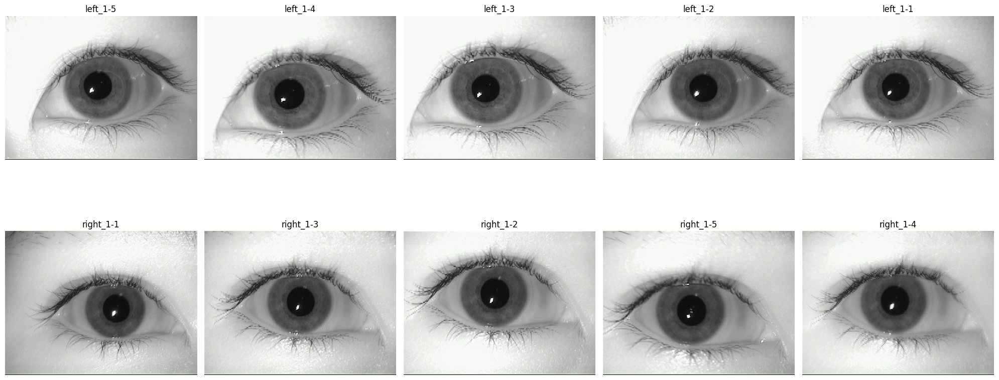

In [6]:
fig, axs = plt.subplots(2, 5, figsize=(20, 10))

for i, (img, label) in enumerate(imgs_dt[:10]):
    axs[i // 5, i % 5].imshow(img)
    axs[i // 5, i % 5].set_title(label)
    axs[i // 5, i % 5].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "eyes_presentation.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

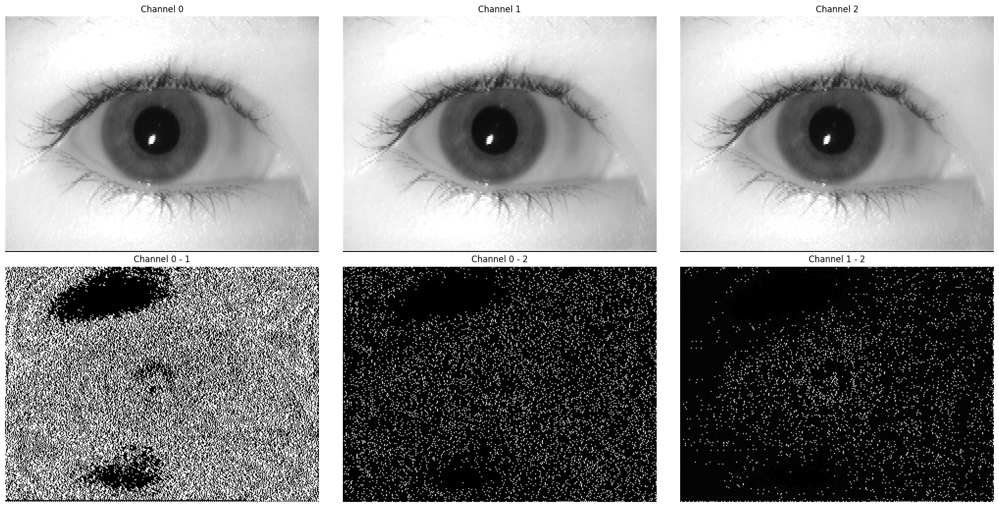

In [7]:
fig, axs = plt.subplots(2, 3, figsize=(20, 10))
axs = axs.ravel()

axs[0].imshow(img[:, :, 0], cmap="gray")
axs[0].set_title("Channel 0")
axs[0].axis("off")

axs[1].imshow(img[:, :, 1], cmap="gray")
axs[1].set_title("Channel 1")
axs[1].axis("off")

axs[2].imshow(img[:, :, 2], cmap="gray")
axs[2].set_title("Channel 2")
axs[2].axis("off")

axs[3].imshow(img[:, :, 0] - img[:, :, 1], cmap="gray")
axs[3].set_title("Channel 0 - 1")
axs[3].axis("off")

axs[4].imshow(img[:, :, 0] - img[:, :, 2], cmap="gray")
axs[4].set_title("Channel 0 - 2")
axs[4].axis("off")

axs[5].imshow(img[:, :, 1] - img[:, :, 2], cmap="gray")
axs[5].set_title("Channel 1 - 2")
axs[5].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "channels_differences.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [8]:
imgs_original = []

for i in range(len(imgs_dt)):
    img = imgs_dt[i][0]
    imgs_original.append(img)
    imgs_dt[i] = (
        0.2989 * img[:, :, 0] + 0.5870 * img[:, :, 1] + 0.1140 * img[:, :, 2],
        imgs_dt[i][1],
    )

imgs_original = np.array(imgs_original)
imgs = np.array([img[0] for img in imgs_dt])
labels = np.array([img[1] for img in imgs_dt])

In [9]:
imgs.shape

(450, 240, 320)

# Detekcja granic źrenicy

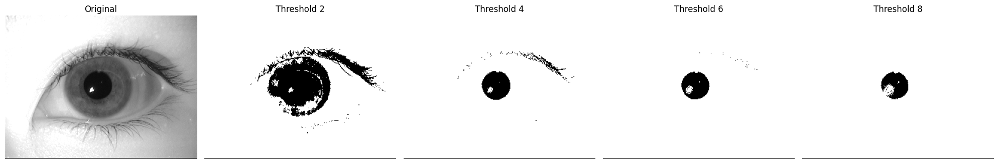

In [10]:
fig, axs = plt.subplots(1, 5, figsize=(20, 10))

img = imgs[0]

axs[0].imshow(img, cmap="gray")
axs[0].set_title("Original")
axs[0].axis("off")

p = np.mean(img)

for i, threshold in enumerate(range(2, 9, 2)):
    axs[i + 1].imshow(img < p / threshold, cmap="binary")
    axs[i + 1].set_title(f"Threshold {threshold}")
    axs[i + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupil_thresholds.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

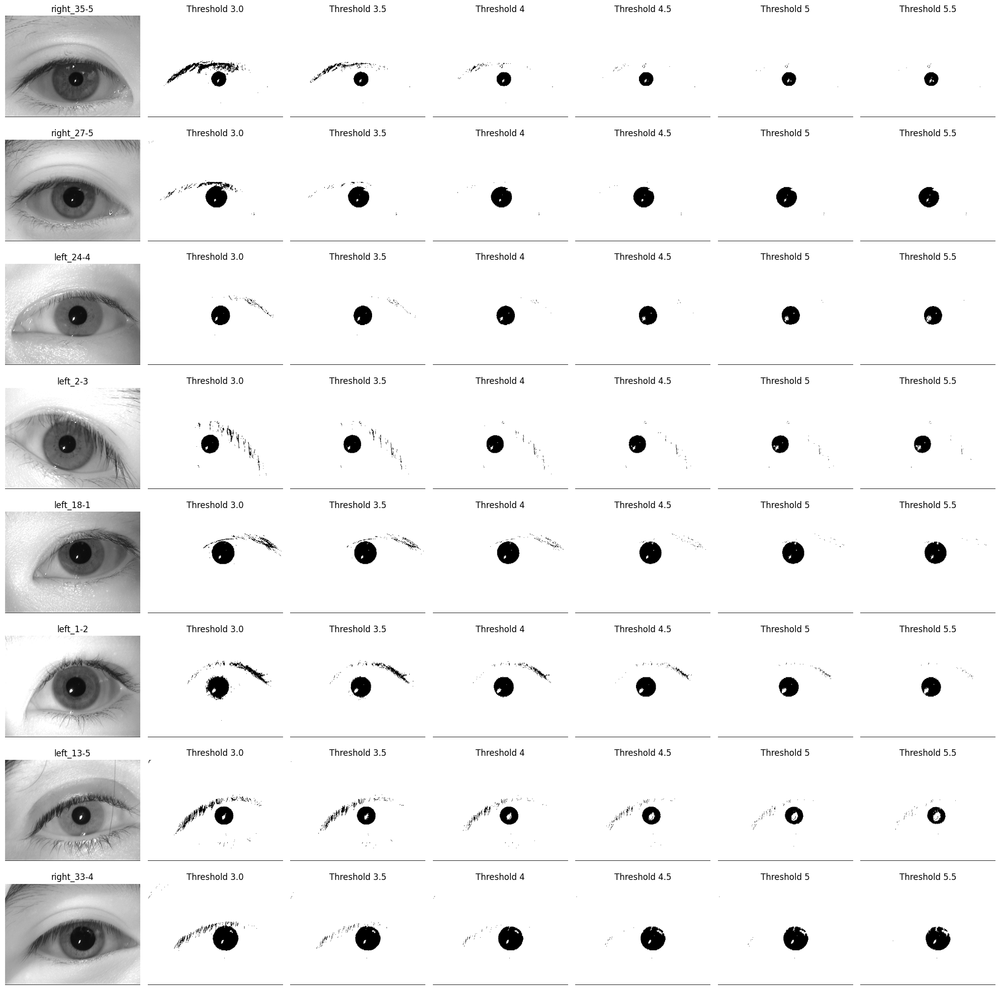

In [11]:
fig, axs = plt.subplots(8, 7, figsize=(20, 20))
axs = axs.ravel()

random_idxs = np.random.randint(0, imgs.shape[0], 8)

for j, k in enumerate(random_idxs):
    img = imgs[k, :, :]
    label = labels[k]
    idx = 7 * j

    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(label)
    axs[idx].axis("off")

    p = np.mean(img)
    for i, threshold in enumerate([3.0, 3.5, 4, 4.5, 5, 5.5]):
        axs[idx + i + 1].imshow(img < p / threshold, cmap="binary")
        axs[idx + i + 1].set_title(f"Threshold {threshold}")
        axs[idx + i + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupil_thresholds_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

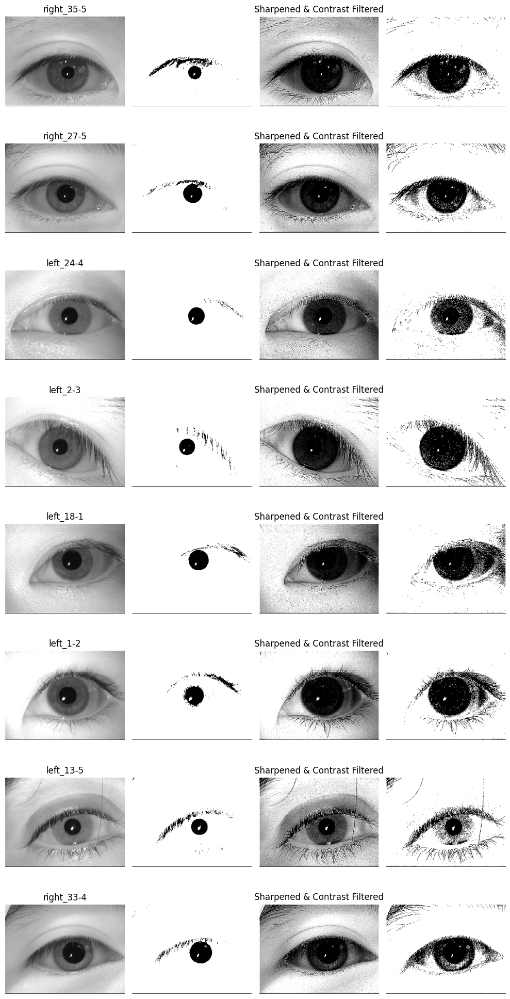

In [12]:
fig, axs = plt.subplots(8, 4, figsize=(10, 20))
axs = axs.ravel()

for j, k in enumerate(random_idxs):
    img = imgs[k, :, :]
    label = labels[k]
    idx = 4 * j

    p = np.mean(img)

    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(label)
    axs[idx].axis("off")

    axs[idx + 1].imshow(img < p / 3.0, cmap="binary")
    axs[idx + 1].axis("off")

    transformed_img = contrast_filter(sharpen(img))
    p = np.mean(transformed_img)

    axs[idx + 2].imshow(transformed_img, cmap="gray")
    axs[idx + 2].set_title("Sharpened & Contrast Filtered")
    axs[idx + 2].axis("off")

    axs[idx + 3].imshow(transformed_img < p / 3.0, cmap="binary")
    axs[idx + 3].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "eye_filters_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

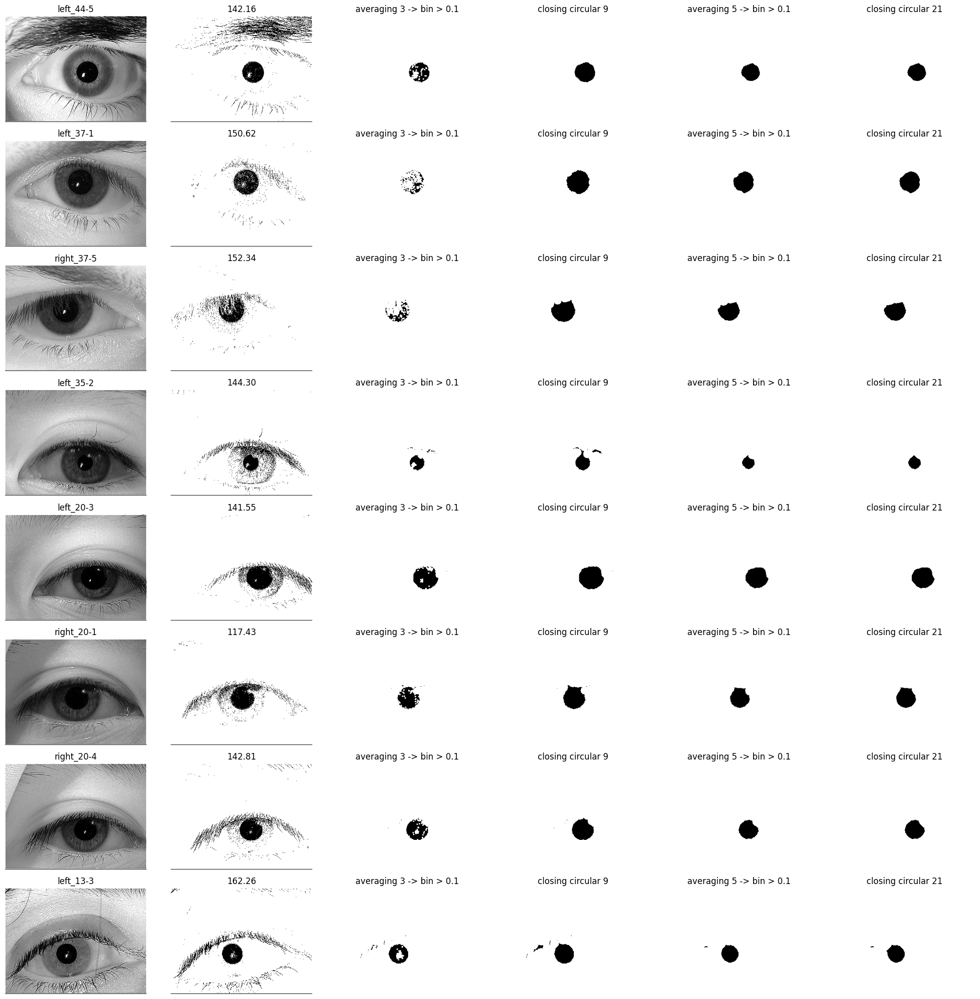

In [13]:
fig, axs = plt.subplots(8, 6, figsize=(20, 20))
axs = axs.ravel()

# for j, k in enumerate(random_idxs):
for j, k in enumerate([374, 300, 305, 281, 124, 127, 128, 44]):
    img = contrast_filter(sharpen(imgs[k, :, :]), factor=1.2)
    label = labels[k]
    idx = 6 * j
    p = np.mean(img)

    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(label)
    axs[idx].axis("off")

    p = np.mean(img)
    img_bin = img < p / 6.0
    axs[idx + 1].imshow(img_bin, cmap="binary")
    axs[idx + 1].set_title(f"{p:.2f}")
    axs[idx + 1].axis("off")

    img_bin = mask_boundary(img_bin, 50)
    img_blur = averaging_filter(img_bin.astype(np.float32), kernel_size=3)
    img_bin = img_blur > 0.1
    axs[idx + 2].imshow(img_bin, cmap="binary")
    axs[idx + 2].set_title(f"averaging 3 -> bin > 0.1")
    axs[idx + 2].axis("off")

    img_closed = closing(img_bin, kernel=circular_kernel(9))
    axs[idx + 3].imshow(img_closed, cmap="binary")
    axs[idx + 3].set_title("closing circular 9")
    axs[idx + 3].axis("off")

    img_blur = averaging_filter(img_closed.astype(np.float32), kernel_size=5)
    img_bin = img_blur > 0.1
    axs[idx + 4].imshow(img_bin, cmap="binary")
    axs[idx + 4].set_title(f"averaging 5 -> bin > 0.1")
    axs[idx + 4].axis("off")

    img_closed = closing(img_bin, kernel=circular_kernel(21))
    axs[idx + 5].imshow(img_closed, cmap="binary")
    axs[idx + 5].set_title("closing circular 21")
    axs[idx + 5].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pulpis_detection_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

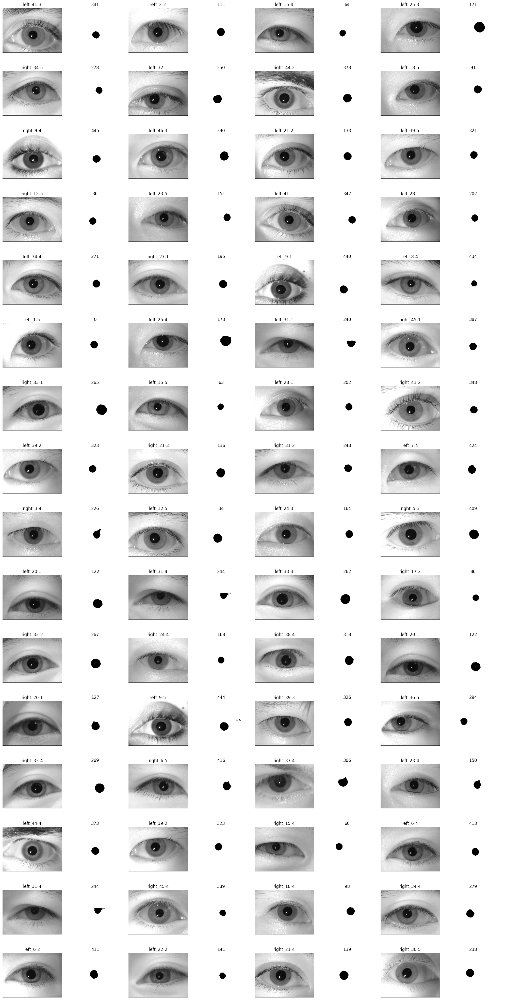

In [14]:
fig, axs = plt.subplots(16, 8, figsize=(20, 40))
axs = axs.ravel()

for j, k in enumerate(np.random.randint(0, imgs.shape[0], 64)):
    img = imgs[k, :, :]
    label = labels[k]
    idx = 2 * j

    transformed_img = transform_pupil_img(img)

    axs[idx].imshow(img, cmap="gray")
    axs[idx + 1].imshow(transformed_img, cmap="binary", alpha=0.5)
    axs[idx].set_title(label)
    axs[idx].axis("off")

    axs[idx + 1].imshow(transformed_img, cmap="binary")
    axs[idx + 1].set_title(k)
    axs[idx + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupils_detected_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [15]:
pupil_imgs = transform_pupil_imgs(imgs)

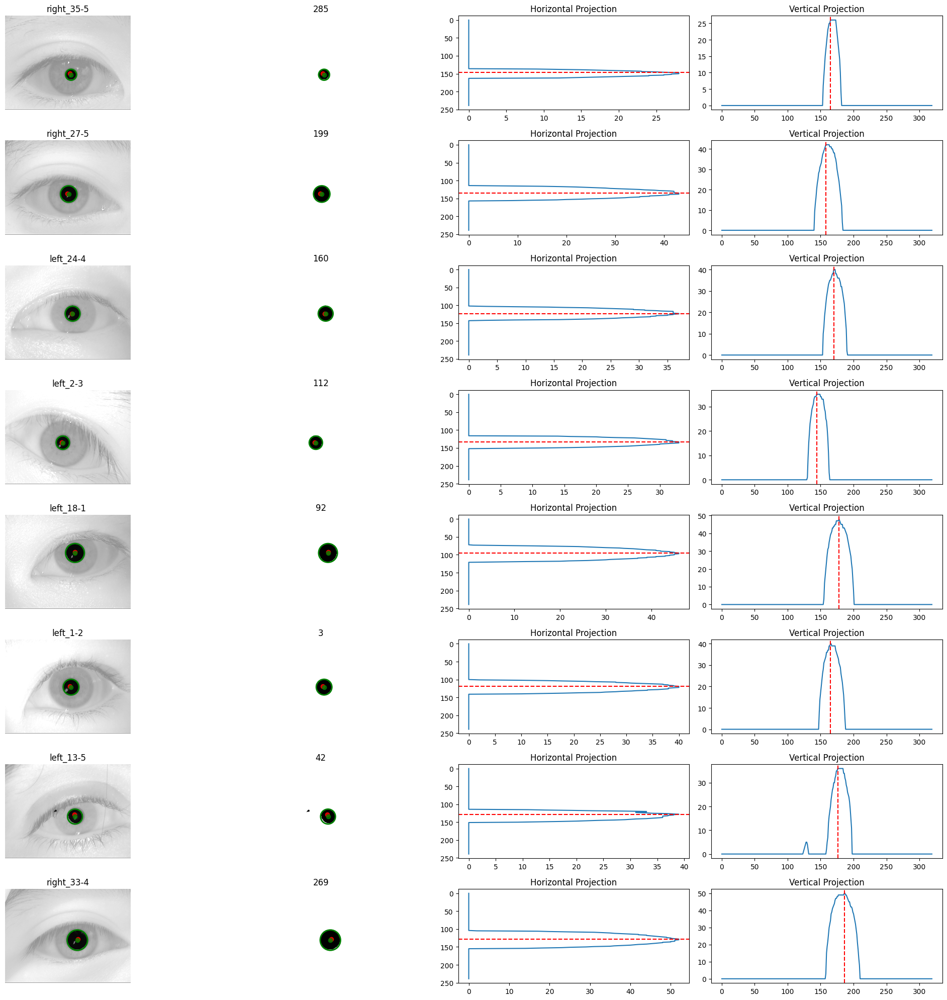

In [16]:
fig, axs = plt.subplots(8, 4, figsize=(20, 20))
axs = axs.ravel()

for j, k in enumerate(random_idxs):
    img = imgs[k, :, :]
    pupil_img = pupil_imgs[k, :, :]
    label = labels[k]
    idx = 4 * j

    axs[idx].imshow(img, cmap="gray")
    axs[idx].imshow(pupil_img, cmap="binary", alpha=0.5)
    axs[idx].set_title(label)
    axs[idx].axis("off")

    axs[idx + 1].imshow(pupil_img, cmap="binary")
    axs[idx + 1].set_title(k)
    axs[idx + 1].axis("off")

    vertical_projection = np.sum(pupil_img, axis=0)
    horizontal_projection = np.sum(pupil_img, axis=1)
    max_horizontal = np.argmax(horizontal_projection)
    max_vertical = np.argmax(vertical_projection)

    axs[idx + 2].plot(horizontal_projection, range(len(horizontal_projection)))
    axs[idx + 2].invert_yaxis()
    axs[idx + 2].axhline(max_horizontal, color="red", linestyle="--", label="Max")
    axs[idx + 2].set_title("Horizontal Projection")

    axs[idx + 3].plot(vertical_projection)
    axs[idx + 3].axvline(max_vertical, color="red", linestyle="--", label="Max")
    axs[idx + 3].set_title("Vertical Projection")

    axs[idx].plot(max_vertical, max_horizontal, "ro", alpha=0.8)
    axs[idx + 1].plot(max_vertical, max_horizontal, "ro", alpha=0.8)

    x, radius_x = analyse_pupil_projection(vertical_projection)
    y, radius_y = analyse_pupil_projection(horizontal_projection)
    iris_radius = np.ceil((radius_x + radius_y) / 2).astype(int)

    axs[idx].plot(x, y, "go", alpha=0.8)
    axs[idx + 1].plot(x, y, "go", alpha=0.8)

    circle = plt.Circle((x, y), iris_radius, color="green", fill=False, linewidth=2)
    axs[idx].add_patch(circle)

    circle = plt.Circle((x, y), iris_radius, color="green", fill=False, linewidth=2)
    axs[idx + 1].add_patch(circle)

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupils_projections_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [17]:
pupils = get_pupils(pupil_imgs)

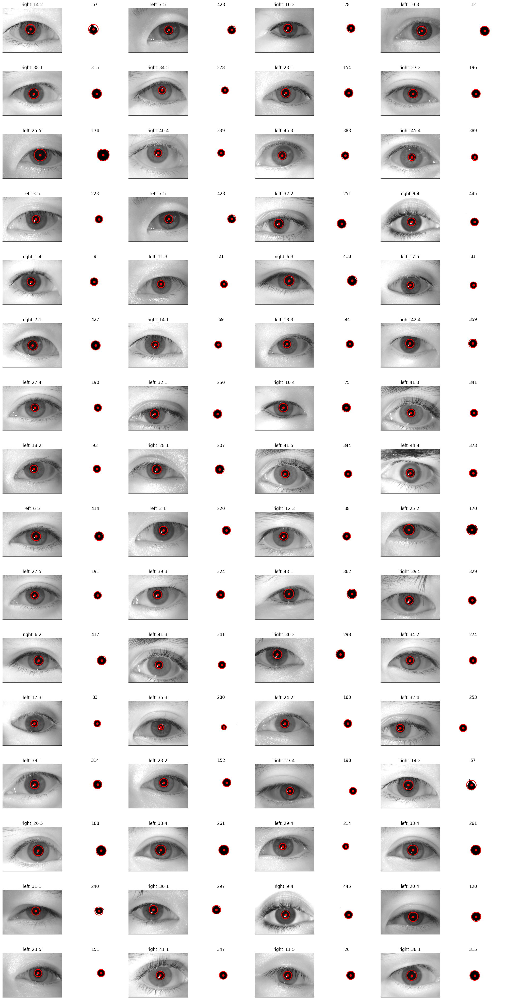

In [18]:
fig, axs = plt.subplots(16, 8, figsize=(20, 40))
axs = axs.ravel()

for j, k in enumerate(np.random.randint(0, imgs.shape[0], 64)):
    img = imgs[k, :, :]
    pupil_img = pupil_imgs[k, :, :]
    center, iris_radius = pupils[k]
    label = labels[k]
    idx = 2 * j

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx].imshow(img, cmap="gray")
    axs[idx].plot(*center, "ro")
    axs[idx].add_patch(circle)
    axs[idx].set_title(label)
    axs[idx].axis("off")

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx + 1].imshow(pupil_img, cmap="binary")
    axs[idx + 1].plot(*center, "ro")
    axs[idx + 1].add_patch(circle)
    axs[idx + 1].set_title(k)
    axs[idx + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupils_detected_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

# Detekcja granic tęczówki

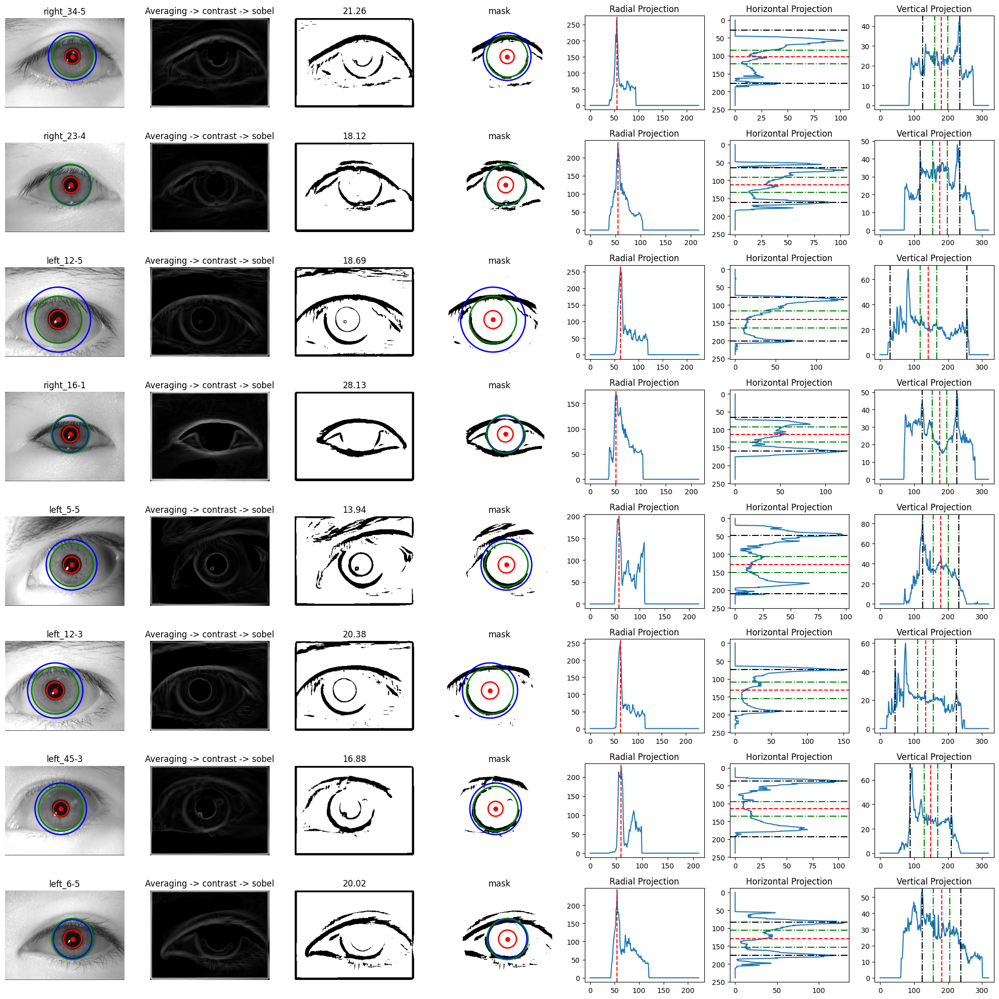

In [19]:
fig, axs = plt.subplots(8, 7, figsize=(20, 20))
axs = axs.ravel()

# for j, k in enumerate(random_idxs):
# for j, k in enumerate([300, 305, 281, 124, 127, 128, 44]):
for j, k in enumerate([278, 158, 34, 77, 404, 32, 383, 414]):
    img = imgs[k, :, :]
    label = labels[k]
    idx = 7 * j

    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(label)
    axs[idx].axis("off")

    img = sobel_filter(contrast_filter(averaging_filter(img, kernel_size=11)))
    p = np.mean(img)

    axs[idx + 1].imshow(img, cmap="gray")
    axs[idx + 1].set_title("Averaging -> contrast -> sobel")
    axs[idx + 1].axis("off")

    p = np.mean(img)
    img_bin = img > p / 0.7
    axs[idx + 2].imshow(img_bin, cmap="binary")
    axs[idx + 2].set_title(f"{p:.2f}")
    axs[idx + 2].axis("off")

    (x, y), pupil_radius = pupils[k]
    img_bin = mask_boundary(img_bin, 10)
    img_bin = mask_circle(img_bin, (x, y), 5 * pupil_radius)
    img_bin = mask_circle(img_bin, (x, y), 1.8 * pupil_radius, inside=False)
    img_bin = img_bin & ~pupil_imgs[k, :, :]

    axs[idx + 3].imshow(img_bin, cmap="binary")
    axs[idx + 3].set_title(f"mask")
    axs[idx + 3].axis("off")

    vertical_projection = np.sum(img_bin, axis=0)
    horizontal_projection = np.sum(img_bin, axis=1)
    radial_projection = get_radial_projection(img_bin, (x, y))

    iris_radus_radial = np.argmax(radial_projection)

    axs[idx + 4].plot(radial_projection)
    axs[idx + 4].set_title("Radial Projection")
    axs[idx + 4].axvline(iris_radus_radial, color="red", linestyle="--", label="Max")

    radius_x = analyse_iris_projection(
        x, pupil_radius=pupil_radius, vector=vertical_projection
    )
    radius_y = analyse_iris_projection(
        y, pupil_radius=pupil_radius, vector=horizontal_projection
    )
    # iris_radius = max(radius_x, radius_y)
    iris_radius = np.ceil((radius_x + radius_y) / 2).astype(int)

    axs[idx + 5].plot(horizontal_projection, range(len(horizontal_projection)))
    axs[idx + 5].axhline(y, color="red", linestyle="--", label="Max")
    axs[idx + 5].axhline(y + pupil_radius, color="green", linestyle="-.")
    axs[idx + 5].axhline(y - pupil_radius, color="green", linestyle="-.")
    axs[idx + 5].axhline(y + radius_y, color="black", linestyle="-.")
    axs[idx + 5].axhline(y - radius_y, color="black", linestyle="-.")
    axs[idx + 5].invert_yaxis()
    axs[idx + 5].set_title("Horizontal Projection")

    axs[idx + 6].plot(vertical_projection)
    axs[idx + 6].axvline(x, color="red", linestyle="--", label="Max")
    axs[idx + 6].axvline(x + pupil_radius, color="green", linestyle="-.")
    axs[idx + 6].axvline(x - pupil_radius, color="green", linestyle="-.")
    axs[idx + 6].axvline(x + radius_x, color="black", linestyle="-.")
    axs[idx + 6].axvline(x - radius_x, color="black", linestyle="-.")
    axs[idx + 6].set_title("Vertical Projection")

    circle_pupil = plt.Circle(
        (x, y), pupil_radius, color="red", fill=False, linewidth=2
    )
    circle_iris = plt.Circle((x, y), iris_radius, color="blue", fill=False, linewidth=2)
    circle_iris_radial = plt.Circle(
        (x, y), iris_radus_radial, color="green", fill=False, linewidth=2
    )
    axs[idx + 3].plot(x, y, "ro")
    axs[idx + 3].add_patch(circle_pupil)
    axs[idx + 3].add_patch(circle_iris)
    axs[idx + 3].add_patch(circle_iris_radial)

    circle_pupil = plt.Circle(
        (x, y), pupil_radius, color="red", fill=False, linewidth=2
    )
    circle_iris = plt.Circle((x, y), iris_radius, color="blue", fill=False, linewidth=2)
    circle_iris_radial = plt.Circle(
        (x, y), iris_radus_radial, color="green", fill=False, linewidth=2
    )
    axs[idx].plot(x, y, "ro")
    axs[idx].add_patch(circle_pupil)
    axs[idx].add_patch(circle_iris)
    axs[idx].add_patch(circle_iris_radial)

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "irises_detection_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [20]:
iris_imgs = transform_iris_imgs(imgs, pupils)

In [21]:
irises = get_irises(iris_imgs, pupils)

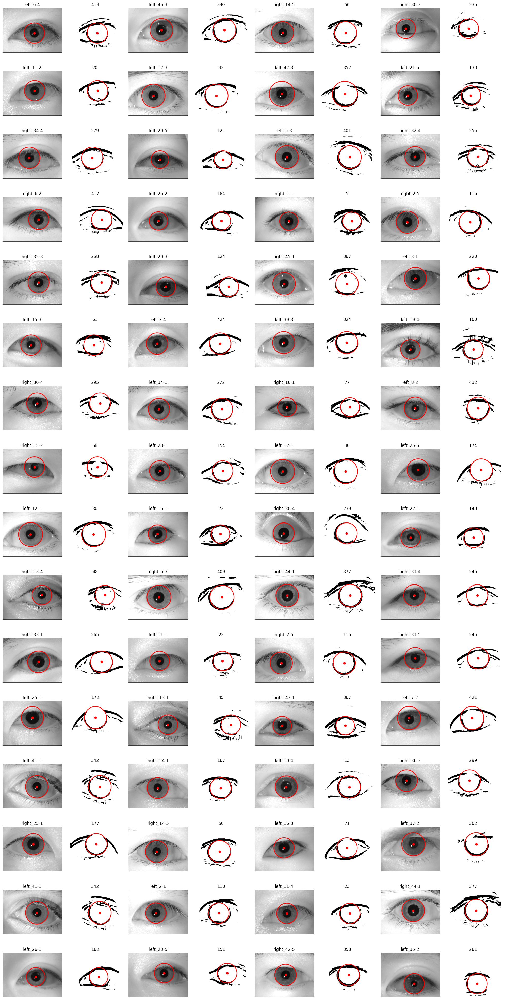

In [22]:
fig, axs = plt.subplots(16, 8, figsize=(20, 40))
axs = axs.ravel()

for j, k in enumerate(np.random.randint(0, imgs.shape[0], 64)):
    img = imgs[k, :, :]
    iris_img = iris_imgs[k, :, :]
    center, iris_radius = irises[k]
    label = labels[k]
    idx = 2 * j

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx].imshow(img, cmap="gray")
    axs[idx].plot(*center, "ro")
    axs[idx].add_patch(circle)
    axs[idx].set_title(label)
    axs[idx].axis("off")

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx + 1].imshow(iris_img, cmap="binary")
    axs[idx + 1].plot(*center, "ro")
    axs[idx + 1].add_patch(circle)
    axs[idx + 1].set_title(k)
    axs[idx + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "irises_detected_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

# Cropping the iris

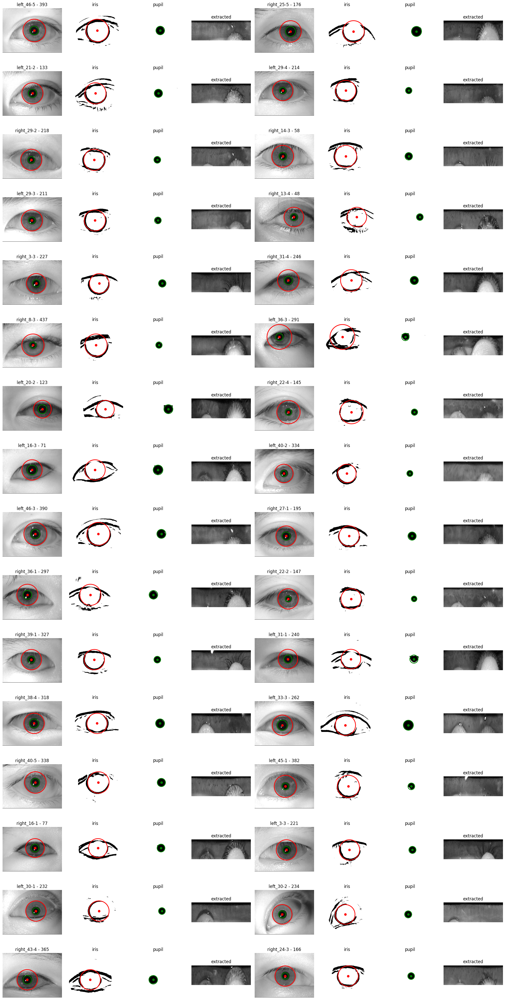

In [23]:
fig, axs = plt.subplots(16, 8, figsize=(20, 40))
axs = axs.ravel()

for j, k in enumerate(np.random.randint(0, imgs.shape[0], 32)):
    img = imgs[k, :, :]
    iris_img = iris_imgs[k, :, :]
    pupil_img = pupil_imgs[k, :, :]
    center, iris_radius = irises[k]
    _, pulipl_radius = pupils[k]
    label = labels[k]
    idx = 4 * j

    iris_circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    pupil_circle = plt.Circle(
        center, pulipl_radius, color="green", fill=False, linewidth=2
    )
    axs[idx].imshow(img, cmap="gray")
    axs[idx].plot(*center, "ro")
    axs[idx].add_patch(iris_circle)
    axs[idx].add_patch(pupil_circle)
    axs[idx].set_title(f"{label} - {k}")
    axs[idx].axis("off")

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx + 1].imshow(iris_img, cmap="binary")
    axs[idx + 1].plot(*center, "ro")
    axs[idx + 1].add_patch(circle)
    axs[idx + 1].set_title("iris")
    axs[idx + 1].axis("off")

    circle = plt.Circle(center, pulipl_radius, color="green", fill=False, linewidth=2)
    axs[idx + 2].imshow(pupil_img, cmap="binary")
    axs[idx + 2].plot(*center, "go")
    axs[idx + 2].add_patch(circle)
    axs[idx + 2].set_title("pupil")
    axs[idx + 2].axis("off")

    iris_part = unwrap_annular_segment(img, center, pulipl_radius, iris_radius)
    axs[idx + 3].imshow(iris_part, cmap="gray")
    axs[idx + 3].set_title("extracted")
    axs[idx + 3].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "final_comphrasion.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [24]:
irises_parts = get_irises_parts(imgs_original, pupils, irises)

In [25]:
irises_parts.shape

(450, 50, 150, 3)

# Saving Results

In [26]:
import warnings

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    save_imgs(imgs, iris_imgs, pupil_imgs, irises_parts, irises, pupils, labels)